# EDA

<b>About this project:</b>

This project contains data analysis as well as building models of activity detection. By these we mean dataset collected from<br> 
phone sensors to train activity detection <b>Edge AI models</b>.

The data set contains folder <i>archive</i> within it there are sets of folders containing collection of activities such as: <b><span style="color:lightblue">Cycling, Sitting, Walking</span></b><br>

To be more precisive the <b>archive</b> structure of folder looks in this way:

<div style="font-family: Arial, sans-serif; line-height: 1.6;">
    <div style="position: relative;">
        <div style="border-left: 2px solid white; padding-left: 10px;">
            <div>archive</div>
            <div style="margin-left: 20px; border-left: 2px solid white; padding-left: 10px;">
                <div>Cycling-2023-09-14_06-22-31</div>
                <div>Cycling-2023-09-14_06-33-47</div>
                <div>Cycling-2023-09-14_06-47-00</div>
                <div>Cycling-2023-09-16_07_43-07</div>
                <div>Cycling-2023-09-16_09_25-09</div>
                <div>Cycling-2023-10-18_06-36-17</div>
                <div>Cycling-2023-10-18_06-51-26</div>
                <div>Sitting-2023-09-14_08-37-45</div>
                <div>Sitting-2023-09-14_09-11-15</div>
                <div>Sitting-2023-10-18_09-05-37</div>
                <div>Walking-2023-09-14_21-51-59</div>
                <div>Walking-2023-09-16_18-14-40</div>
            </div>
        </div>
    </div>
</div><br>

In each folder the structure looks in a given way:

<div style="font-family: Arial, sans-serif; line-height: 1.6;">
    <div style="position: relative;">
        <div style="border-left: 2px solid white; padding-left: 10px;">
            <div>"folder_name"</div>
            <div style="margin-left: 20px; border-left: 2px solid white; padding-left: 10px;">
                <div>Accelerometer.csv</div>
                <div>Annotation.csv</div>
                <div>Gravity.csv</div>
                <div>Gyroscope.csv</div>
                <div>Location.csv</div>
                <div>LocationGps.csv</div>
                <div>LocationNetwork.csv</div>
                <div>Magnetometer.csv</div>
                <div>Metadata.csv</div>
                <div>Orientation.csv</div>
                <div>Pedometer.csv</div>
                <div>TotalAcceleration.csv</div>
            </div>
        </div>
    </div>
</div><br>

The sources can be found at this link:<br>
https://www.kaggle.com/datasets/luisomoreau/activity-detection

## Cel biznesowy

<b>Rozwiązanie z jakiego mogą korzystać serwisu typu <span style="color:green">Spotify</span>, <span style="color:pink">Apple Music</span>:</b>

Stworzenie zaawansowanego systemu rekomendacji muzyki.<br>
Dzięki śledzeniu lokalizacji użytkownika będziemy w stanie określić,<br> 
jaki rodzaj muzyki oraz jacy wykonawcy będą dla niego najbardziej odpowiedni.<br>


<b>Rozwiązania dla sekcji marketingu i reklamy:</b>

Spersonalizowane rekalmy. Reklamodawcy mogą dostarczać spersonalizowane oferty w oparciu o aktywność użytkownika.<br>
 Na przykład, osoba często jeżdżąca na rowerze może otrzymywać reklamy sprzętu rowerowego lub odzieży sportowej.<br>


<b>Zastosowanie dla firm ubezpieczeniowych:</b>

Czy klienci zakładów ubezpieczeniowych prowadzą zdrowy tryb życia, czy się ruszają w trakcie dnia.<br>
Oferowanie zniżek na ubezpieczenia zdrowotne i komunikacyjne dla osób prowadzących aktywny tryb życia.<br> 


In [25]:
# imports
import os
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn_extra.cluster import KMedoids
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from scipy.stats import mode
import plotly.express as px
from pandas.api.types import CategoricalDtype
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import numpy as np


import warnings
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from scipy.stats import mode

## Reading data


In [26]:
# Ścieżka do folderu zawierającego podfoldery z plikami CSV
base_path = "archive"
# Funkcja do załadowania wszystkich plików CSV z folderu do słownika DataFrame'ów
def load_csv_files(folder_path):
    data_frames = {}
    for file_name in os.listdir(folder_path):
        if file_name.endswith('.csv') and 'Annotation' not in file_name:
            df_name = file_name.replace('.csv', '')
            df_path = os.path.join(folder_path, file_name)
            try:
                df = pd.read_csv(df_path)
                if df.empty or df.shape[1] == 0:
                    print(f"Pusty plik pominięty: {df_path}")
                    continue
                data_frames[df_name] = df
            except pd.errors.EmptyDataError:
                print(f"Błąd: Pusty plik CSV pominięty: {df_path}")
    return data_frames

# Funkcja do znalezienia najbliższej wartości time
def merge_on_nearest_time(df1, df2, df2_name, time_column='time'):
    df1[time_column] = pd.to_datetime(df1[time_column])
    df2[time_column] = pd.to_datetime(df2[time_column])
    
    # Zmiana nazw kolumn w df2, dodanie prefiksu, aby wiadomo było skąd pochodzą
    df2 = df2.rename(columns=lambda x: f"{df2_name}_{x}" if x != time_column else x)
    
    merged_df = pd.merge_asof(df1.sort_values(time_column), 
                              df2.sort_values(time_column), 
                              on=time_column, 
                              direction='nearest')
    
    # Usuń dodatkowe kolumny seconds_elapsed, jeśli istnieją
    for col in merged_df.columns:
        if 'seconds_elapsed' in col and col != 'seconds_elapsed':
            merged_df.drop(columns=[col], inplace=True)
    
    return merged_df

# Funkcja do przetwarzania plików CSV w folderze
def process_folder(folder_path, label):
    csv_files = load_csv_files(folder_path)
    
    if 'Location' not in csv_files:
        print(f"Błąd: Brak pliku Location w folderze: {folder_path}")
        return None
    
    # Zaczynamy od Location
    merged_df = csv_files['Location']
    
    # Lista plików do zmergowania
    files_to_merge = ['Gyroscope', 'Magnetometer', 'Orientation', 'Accelerometer', 'Gravity','Pedometer','TotalAcceleration']
    
    # LEFT JOIN z najbliższą wartością time dla każdego z plików
    for file_name in files_to_merge:
        if file_name in csv_files:
            merged_df = merge_on_nearest_time(merged_df, csv_files[file_name], file_name)
        else:
            print(f"Ostrzeżenie: Brak pliku {file_name} w folderze: {folder_path}")
    
    # Dodajemy kolumnę label
    merged_df['label'] = label
    
    # Przemianowanie kolumn, aby uniknąć duplikatów
    merged_df = merged_df.loc[:, ~merged_df.columns.duplicated()]
    
    return merged_df

# Funkcja do automatycznego pobierania wszystkich folderów i ich etykiet
def get_folders_and_labels(base_path):
    folders_and_labels = []
    for folder_name in os.listdir(base_path):
        if os.path.isdir(os.path.join(base_path, folder_name)):
            if 'Cycling' in folder_name:
                label = 'Cycling'
            elif 'Sitting' in folder_name:
                label = 'Sitting'
            elif 'Walking' in folder_name:
                label = 'Walking'
            else:
                label = 'Unknown'  # Dodajemy etykietę dla nieznanych aktywności, jeśli jest to potrzebne
            folders_and_labels.append((folder_name, label))
    return folders_and_labels

# Pobieranie wszystkich folderów i ich etykiet
folders = get_folders_and_labels(base_path)

# Kolekcja DataFrame'ów
data_frames_collection = {}

# Przetwarzanie każdego folderu
for folder_name, label in folders:
    folder_path = os.path.join(base_path, folder_name)
    df = process_folder(folder_path, label)
    if df is not None:
        data_frames_collection[folder_name] = df

## Merging df's and printing columns

In [27]:
# Połączenie wszystkich DataFrame'ów w jednym DataFrame
merged_df = pd.concat(data_frames_collection.values(), ignore_index=True)

# Pobranie aktualnych nazw kolumn
columns = merged_df.columns.tolist()

# Zmiana nazw kolumn od trzeciej do jedenastej, dodanie przedrostka 'location_'
for i in range(2, 11):  # Indeksowanie od 0, więc kolumna 3 to indeks 2
    columns[i] = f'location_{columns[i]}'

# Ustawienie zmienionych nazw kolumn z powrotem w DataFrame
merged_df.columns = columns

# Wyświetlenie zmodyfikowanych nazw kolumn
print(merged_df.columns)

# Opcjonalnie: zapisanie połączonego DataFrame do pliku CSV
# merged_df.to_csv('merged_data.csv', index=False)

Index(['time', 'seconds_elapsed', 'location_bearingAccuracy',
       'location_speedAccuracy', 'location_verticalAccuracy',
       'location_horizontalAccuracy', 'location_speed', 'location_bearing',
       'location_altitude', 'location_longitude', 'location_latitude',
       'Gyroscope_z', 'Gyroscope_y', 'Gyroscope_x', 'Magnetometer_z',
       'Magnetometer_y', 'Magnetometer_x', 'Orientation_qz', 'Orientation_qy',
       'Orientation_qx', 'Orientation_qw', 'Orientation_roll',
       'Orientation_pitch', 'Orientation_yaw', 'Accelerometer_z',
       'Accelerometer_y', 'Accelerometer_x', 'Gravity_z', 'Gravity_y',
       'Gravity_x', 'Pedometer_steps', 'TotalAcceleration_z',
       'TotalAcceleration_y', 'TotalAcceleration_x', 'label'],
      dtype='object')


Explanation of the columns meaning:<br>

There weren't included any additional informations about columns descriptions, that is why all descriptions of columns included below have been transcribed by guesswork.<br>



1. <b>time</b>: The time at which the data was recorded.<br>
2. <b>seconds_elapsed</b>: The number of seconds that have elapsed since the start of data recording.<br>
3. <b>location_bearingAccuracy</b>: The accuracy of the bearing measurement in degrees.<br>
4. <b>location_speedAccuracy</b>: The accuracy of the speed measurement.<br>
5. <b>location_verticalAccuracy</b>: The accuracy of the vertical measurement.<br>
6. <b>location_horizontalAccuracy</b>: The accuracy of the horizontal measurement.<br>
7. <b>location_speed</b>: The speed of movement.<br>
8. <b>location_bearing</b>: The direction of movement in degrees from north (azimuth).<br>
9. <b>location_altitude</b>: The altitude above sea level.<br>
10. <b>location_longitude</b>: The geographic longitude.<br>
11. <b>location_latitude</b>: The geographic latitude.<br>

Inertial Sensors:<br>

12, 13, 14. <b>Gyroscope_z, Gyroscope_y, Gyroscope_x</b>: Measurement of angular velocity around the z, y, x axes (gyroscope).<br>
15, 16, 17. <b>Magnetometer_z, Magnetometer_y, Magnetometer_x</b>: Measurement of the magnetic field around the z, y, x axes (magnetometer).<br>
18, 19, 20, <b>21.Orientation_qz, Orientation_qy, Orientation_qx, Orientation_qw</b>: Orientation quaternions that describe spatial orientation.<br>
22, 23, 24. <b>Orientation_roll, Orientation_pitch, Orientation_yaw</b>: Orientation in terms of roll, pitch, and yaw angles.<br>
25, 26, 27. <b>Accelerometer_z, Accelerometer_y, Accelerometer_x</b>:
 Linear acceleration around the z, y, x axes (accelerometer).<br><br>
28, 29, 30. <b>Gravity_z, Gravity_y, Gravity_x</b>: Components of the gravitational vector around the z, y, x axes.<br>
31. <b>Pedometer_steps</b>: The number of steps recorded by the pedometer.<br>
32, 33, 34. <b>TotalAcceleration_z, TotalAcceleration_y, TotalAcceleration_x</b>: Total acceleration around the z, y, x axes, which may include both gravitational and linear acceleration.<br>

Other:<br>

35. <b>label</b>: The activity label (e.g., walking, sitting, cycling), which is the target for prediction in clustering.<br>

<span style="color:red">We will get rid of </span><b> label  </b> <span style="color:red">later, and we are struggling with the problem of unsupervised learning</span>

# Spliting to training and validation set

In [28]:
import pandas as pd
from sklearn.model_selection import train_test_split

train_val_df, validation_team_df = train_test_split(merged_df, test_size=0.3, random_state=42)

# Podział zbioru zespołu budującego na zbiór treningowy (70%) i walidacyjny (30%)
train_df, validation_df = train_test_split(train_val_df, test_size=0.3, random_state=42)

In [29]:
#saving basic data frame, used in feature engineering section
validation_team_df.to_csv('validation_team_df_kasia_nazarii.csv', index=False)
validation_df.to_csv('building_team_validation.csv',index=False)

In [30]:
#WE ARE ONLY USING TRAIN DATA SET
merged_df=train_df

In [32]:
merged_df.head()

,time,seconds_elapsed,location_bearingAccuracy,location_speedAccuracy,location_verticalAccuracy,location_horizontalAccuracy,location_speed,location_bearing,location_altitude,location_longitude,...,Accelerometer_y,Accelerometer_x,Gravity_z,Gravity_y,Gravity_x,Pedometer_steps,TotalAcceleration_z,TotalAcceleration_y,TotalAcceleration_x,label
1309,2023-09-16 07:46:08.347979800,181.219980,0.0,0.0,100.688080,4.327,3.441745,287.630646,69.200005,3.123538,...,0.984459,-3.384442,-3.795144,-9.017409,0.673492,326,-2.60505,-8.032950,-2.710950,Cycling
1973,2023-09-16 07:54:30.318000000,683.190000,11.7,1.6,12.900000,3.900,6.513446,275.857147,55.900000,3.105743,...,-0.931252,0.933753,-4.114718,-8.892698,0.399297,1156,-6.05595,-9.823951,1.333050,Cycling
636,2023-09-14 06:39:57.308000000,369.861000,7.9,1.4,8.211334,4.312,6.852551,312.237671,69.200005,3.117246,...,-0.638681,-2.344504,-2.513278,-3.186319,8.927554,420,-2.51100,-3.825000,6.583050,Cycling
4554,2023-10-18 06:43:31.028680200,433.501680,0.0,0.0,5.467222,6.788,3.798128,308.235016,68.300003,3.118775,...,0.294391,1.215064,-6.995914,-6.861391,0.385886,626,-7.21095,-6.567000,1.600950,Cycling
4036,2023-09-16 09:46:18.578459400,1269.336459,0.0,0.0,14.300000,6.877,3.146294,140.709763,87.300000,3.137749,...,-0.088854,-1.195276,-1.360576,-2.272146,9.442277,2099,-1.43895,-2.361000,8.247001,Cycling


## checking whether the are lacks od data

In [33]:
def check_missing_values(df):
    missing_info = {}
    total_values = len(df)
    
    for column in df.columns:
        missing_count = df[column].isnull().sum()
        missing_percentage = (missing_count / total_values) * 100
        missing_info[column] = {
            'missing_count': missing_count,
            'missing_percentage': missing_percentage
        }
        
    return missing_info

# Sprawdzenie braków danych w merged_df
missing_data_info = check_missing_values(merged_df)

# Wyświetlenie informacji o brakach danych
for column, info in missing_data_info.items():
    print(f"Column: {column}")
    print(f"  Missing values: {info['missing_count']} ({info['missing_percentage']:.2f}%)")

Column: time
  Missing values: 0 (0.00%)
Column: seconds_elapsed
  Missing values: 0 (0.00%)
Column: location_bearingAccuracy
  Missing values: 0 (0.00%)
Column: location_speedAccuracy
  Missing values: 0 (0.00%)
Column: location_verticalAccuracy
  Missing values: 0 (0.00%)
Column: location_horizontalAccuracy
  Missing values: 0 (0.00%)
Column: location_speed
  Missing values: 0 (0.00%)
Column: location_bearing
  Missing values: 0 (0.00%)
Column: location_altitude
  Missing values: 0 (0.00%)
Column: location_longitude
  Missing values: 0 (0.00%)
Column: location_latitude
  Missing values: 0 (0.00%)
Column: Gyroscope_z
  Missing values: 0 (0.00%)
Column: Gyroscope_y
  Missing values: 0 (0.00%)
Column: Gyroscope_x
  Missing values: 0 (0.00%)
Column: Magnetometer_z
  Missing values: 0 (0.00%)
Column: Magnetometer_y
  Missing values: 0 (0.00%)
Column: Magnetometer_x
  Missing values: 0 (0.00%)
Column: Orientation_qz
  Missing values: 0 (0.00%)
Column: Orientation_qy
  Missing values: 0 (0.

- it looks like there are not lacks in data

## checking what is better choice Normalization or Standarization

- hence we will begin from distribution side

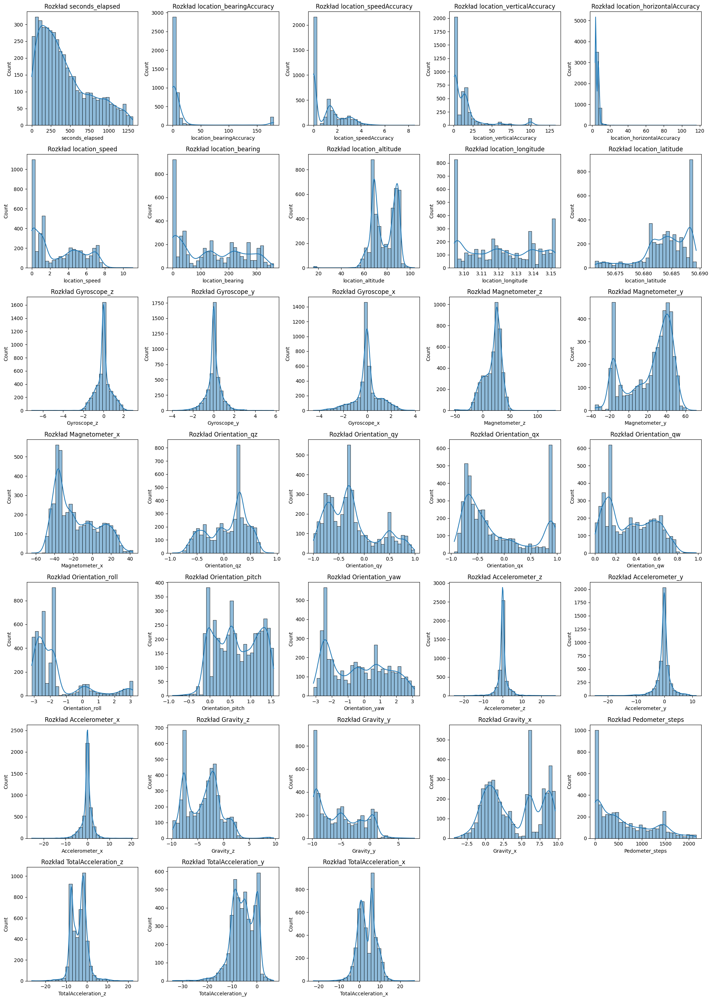

In [34]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Zakładam, że 'merged_df' jest już załadowany

# Funkcja do tworzenia histogramów dla wszystkich kolumn w DataFrame
def plot_distributions(df, cols_per_row=5):
    numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
    num_cols = len(numeric_cols)
    num_rows = (num_cols // cols_per_row) + (num_cols % cols_per_row > 0)

    fig, axes = plt.subplots(num_rows, cols_per_row, figsize=(20, 4 * num_rows))
    axes = axes.flatten()

    for i, col in enumerate(numeric_cols):
        sns.histplot(df[col].dropna(), bins=30, kde=True, ax=axes[i])
        axes[i].set_title(f'Rozkład {col}')

    # Wyłącz puste osie
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

# Wywołanie funkcji do tworzenia wykresów
plot_distributions(merged_df)

In [35]:
#coping data frame, cause the version before normalization and logarithmizing some columns will be used in elbow plot

merged_df_copy= merged_df.copy()

In [36]:
#saving basic data frame, used in feature engineering section
merged_df_copy.to_csv('pre_feature_engineering_data.csv', index=False)

## Changing scale of some plots for better effects

In [11]:
#below are some columns for which we decided to use log scale
columns_to_log_scale = [
    'location_bearingAccuracy',
    'location_speedAccuracy',
    'location_verticalAccuracy',
    'location_horizontalAccuracy',
    'location_speed',
    'location_bearing',
    'Pedometer_steps'
]

# Przeskalowanie logarytmiczne wybranych kolumn
for column in columns_to_log_scale:
    merged_df[column] = np.log1p(merged_df[column])

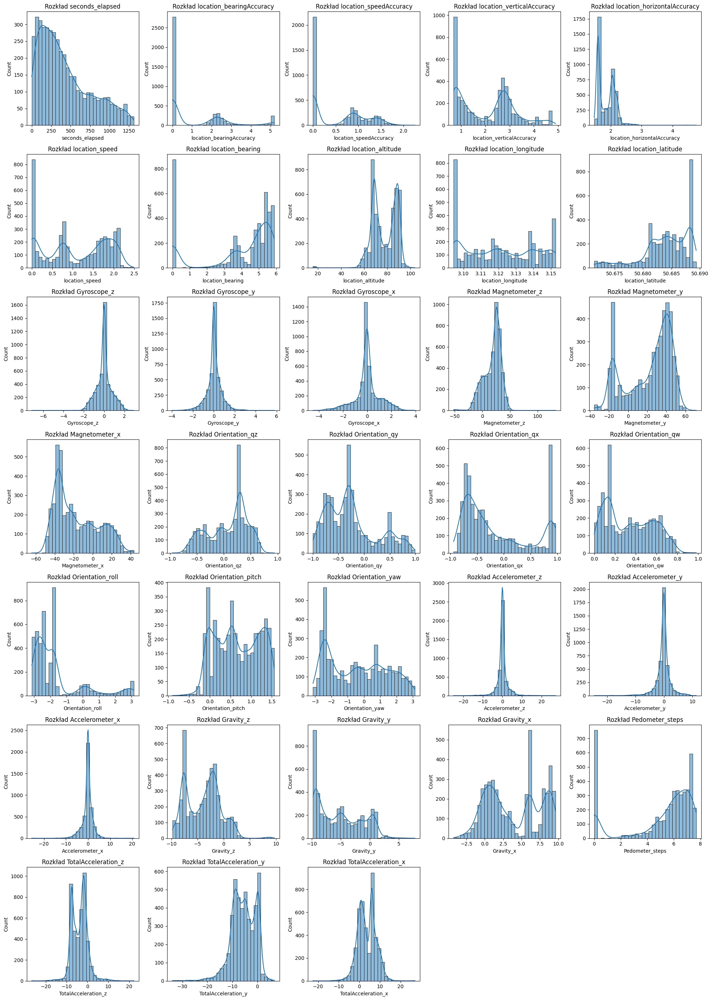

In [12]:
#results after using log scale for some columns
plot_distributions(merged_df)

In [13]:
missing_values = merged_df.isnull().sum()

# Wyświetlenie kolumn, które zawierają brakujące wartości
print(missing_values[missing_values > 0])

Series([], dtype: int64)


In [14]:
import os
import pandas as pd
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Funkcja do normalizacji danych
def normalize_data(df):
    scaler = MinMaxScaler()
    numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
    df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    return df

# Funkcja do standaryzacji danych
def standardize_data(df):
    scaler = StandardScaler()
    numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
    df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    return df

# Przekształcanie danych
normalized_df = normalize_data(merged_df.copy())
standardized_df = standardize_data(merged_df.copy())

# Klasteryzacja K-means
def perform_clustering(df, n_clusters=3):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(df.select_dtypes(include=['float64', 'int64']))
    score = silhouette_score(df.select_dtypes(include=['float64', 'int64']), labels)
    return labels, score

# Wykonanie klasteryzacji i obliczenie współczynnika Silhouette
normalized_labels, normalized_silhouette_score = perform_clustering(normalized_df)
standardized_labels, standardized_silhouette_score = perform_clustering(standardized_df)

print(f"Współczynnik Silhouette dla znormalizowanych danych: {normalized_silhouette_score}")
print(f"Współczynnik Silhouette dla standaryzowanych danych: {standardized_silhouette_score}")

# Wybór lepszego przekształcenia
if normalized_silhouette_score > standardized_silhouette_score:
    print("Normalizacja danych daje lepsze wyniki klasteryzacji.")
else:
    print("Standaryzacja danych daje lepsze wyniki klasteryzacji.")

c:\Program Files\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Program Files\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Współczynnik Silhouette dla znormalizowanych danych: 0.2657982286419554
Współczynnik Silhouette dla standaryzowanych danych: 0.21191869279007863
Normalizacja danych daje lepsze wyniki klasteryzacji.


- it is better to do Normalization rather then Standarization, cause of Silhhoutte score

In [15]:
import os
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Funkcja do normalizacji danych
def normalize_data(df):
    scaler = MinMaxScaler()
    numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
    df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    return df

# Przekształcanie danych i nazwanie final_df
final_df = normalize_data(merged_df.copy())

# Klasteryzacja K-means
def perform_clustering(df, n_clusters=3):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(df.select_dtypes(include=['float64', 'int64']))
    score = silhouette_score(df.select_dtypes(include=['float64', 'int64']), labels)
    return labels, score

# Wykonanie klasteryzacji i obliczenie współczynnika Silhouette
final_labels, final_silhouette_score = perform_clustering(final_df)

print(f"Współczynnik Silhouette dla znormalizowanych danych: {final_silhouette_score}")

# Dodanie etykiet klastrów do DataFrame final_df
final_df['cluster'] = final_labels

c:\Program Files\Python38\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Współczynnik Silhouette dla znormalizowanych danych: 0.2657982286419554


In [16]:
# Wyświetlanie wyników klasteryzacji
final_df.head()

,time,seconds_elapsed,location_bearingAccuracy,location_speedAccuracy,location_verticalAccuracy,location_horizontalAccuracy,location_speed,location_bearing,location_altitude,location_longitude,...,Accelerometer_x,Gravity_z,Gravity_y,Gravity_x,Pedometer_steps,TotalAcceleration_z,TotalAcceleration_y,TotalAcceleration_x,label,cluster
1309,2023-09-16 07:46:08.347979800,0.138156,0.000000,0.000000,0.935374,0.062383,0.598681,0.962014,0.605889,0.501374,...,0.478297,0.308161,0.044856,0.355257,0.754156,0.492123,0.635572,0.399213,Cycling,1
1973,2023-09-16 07:54:30.318000000,0.521125,0.488963,0.424428,0.461583,0.037032,0.809737,0.954942,0.455266,0.195976,...,0.571754,0.291779,0.051947,0.335487,0.918747,0.421533,0.591776,0.480869,Cycling,1
636,2023-09-14 06:39:57.308000000,0.282076,0.420561,0.388874,0.363622,0.061528,0.827461,0.975907,0.605889,0.393390,...,0.500804,0.373873,0.376410,0.950384,0.787068,0.494047,0.738471,0.586876,Cycling,1
4554,2023-10-18 06:43:31.028680200,0.330629,0.000000,0.000000,0.279415,0.177618,0.629669,0.973723,0.595697,0.419640,...,0.577842,0.144081,0.167446,0.334520,0.838949,0.397906,0.671419,0.486278,Cycling,1
4036,2023-09-16 09:46:18.578459400,0.968314,0.000000,0.000000,0.484430,0.181066,0.571043,0.841215,0.810872,0.745270,...,0.525676,0.432964,0.428389,0.987496,0.996391,0.515977,0.774270,0.620474,Cycling,1


In [17]:
#we can't use PCA as we mixed normalization and standarization
#we will try to use VarianceThreshold

import pandas as pd
from sklearn.feature_selection import VarianceThreshold

# Zakładamy, że 'modified_features' to DataFrame z Twoimi danymi
# Wykluczamy kolumny 'label', 'cluster', 'time' i 'seconds_elapsed'
features_to_include = [col for col in final_df.columns if col not in ['label', 'cluster', 'time', 'seconds_elapsed']]
data_for_selection = final_df[features_to_include]

#wykluczamy kolumny 'label'-poniewaz jest informacja o klustrze do jakiego nalezy obserwacja(pozniej pozbedziemy sie tej kolumny)
#'cluster' ponieważ jest klastrem powstalym z uzyciem kmeans, nie mozemy pozbyc sie tej cechy poniewaz na niej poczescie opiera sie nasza EDA i widocznosc klustrow
#'time' oraz 'seconds_elapsed', z seconds_elapsed mamy bardzo duzo informacji czasowych, ktore pozniej sa wykorzystywane do tworzenia wizualizacji, widac lepsze clustry
#na zmiennych zaleznych od czasu niz od innych, to samo mozna powiedziec z 'time'

# Ustawienie progu wariancji na 0.01
threshold = 0.01

# Zastosowanie VarianceThreshold do identyfikacji cech o niskiej wariancji
selector = VarianceThreshold(threshold=threshold)
selector.fit(data_for_selection)

# Identyfikacja cech o niskiej wariancji
low_variance_features = [column for column, var in zip(data_for_selection.columns, selector.variances_) if var < threshold]

print(f"Cechy o niskiej wariancji (threshold < {threshold}):")
print(low_variance_features)

#but as for know we will not try to delete these as they will be needed for later visualizations

Cechy o niskiej wariancji (threshold < 0.01):
['location_horizontalAccuracy', 'Gyroscope_z', 'Gyroscope_y', 'Magnetometer_z', 'Accelerometer_z', 'Accelerometer_y', 'Accelerometer_x', 'TotalAcceleration_z', 'TotalAcceleration_x']


correlation matrix to find variables highly correlated to delete some features, will be used later in the secion of feature engineering

C:\Users\igorr\AppData\Local\Temp\ipykernel_18988\3070994606.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = final_df.corr()


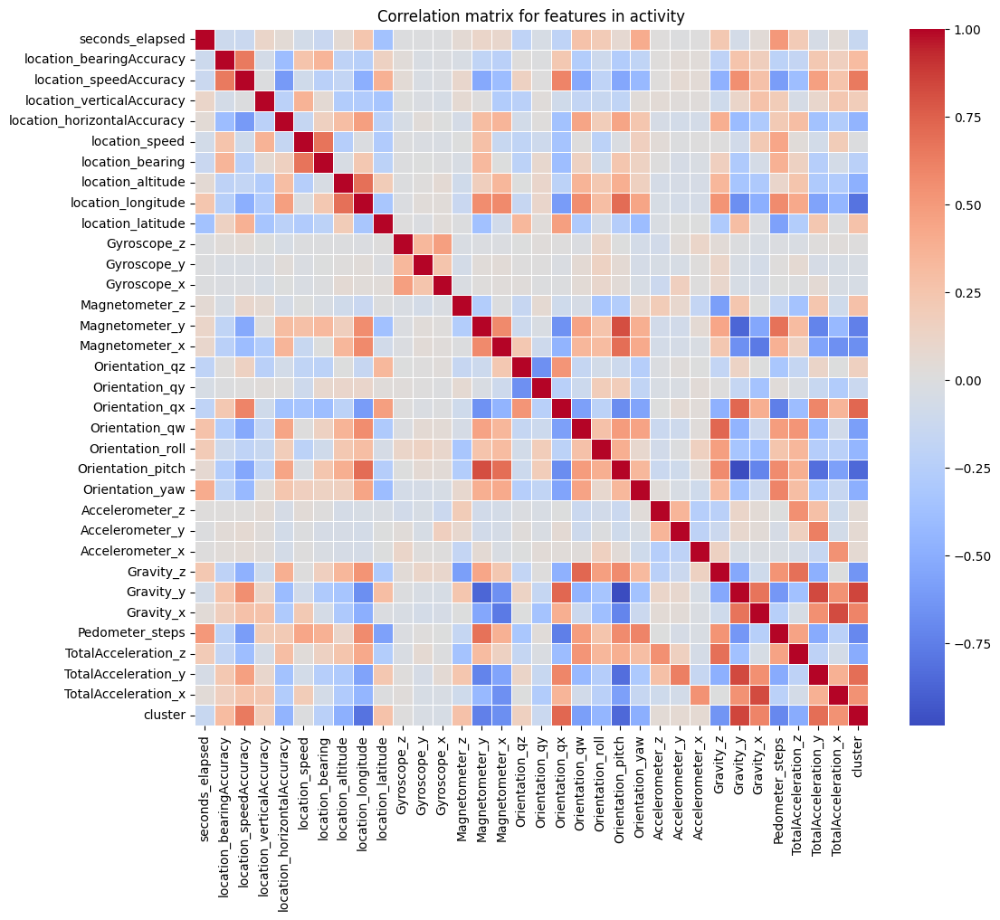

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

# Obliczanie macierzy korelacji
correlation_matrix = final_df.corr()

# Rysowanie heatmapy macierzy korelacji bez wartości
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation matrix for features in activity')
plt.show()

Conclusions from correlation matrix:

<span style="color:red">High Correlation Pairs</span>:

Gyroscope_x and Gyroscope_y: Strong positive correlation.
Accelerometer_x and Accelerometer_y: Strong positive correlation.
Orientation_qx, Orientation_qy, and Orientation_qz: These orientation components are highly correlated with each other, indicating that they vary together.
TotalAcceleration_x and Gravity_x: High correlation, indicating that the total acceleration in the x-axis is significantly influenced by gravity in the x-axis.

<span style="color:blue">Negative Correlation Pairs</span>:

Gravity_y and Magnetometer_y: Strong negative correlation.
Orientation_yaw and Accelerometer_y: Negative correlation suggests that as one increases, the other decreases.<br>

<b>For now we will leave those features, we will not do dimension reduction in exploratory data analysis section</b>


In [19]:
import pandas as pd
import numpy as np

# Zakładamy, że 'final_df' to DataFrame z Twoimi danymi
# Wyklucz kolumny 'label', 'cluster', 'time' i 'seconds_elapsed'
features_to_include = [col for col in final_df.columns if col not in ['label', 'cluster', 'time', 'seconds_elapsed']]
data_for_selection = final_df[features_to_include]

# Obliczanie macierzy korelacji
correlation_matrix = data_for_selection.corr()

# Ustawienie progu korelacji
threshold = 0.9

# Zidentyfikowanie par kolumn, które są silnie skorelowane
high_corr_pairs = []

for i in range(len(correlation_matrix.columns)):
    for j in range(i + 1, len(correlation_matrix.columns)):
        corr_value = correlation_matrix.iloc[i, j]
        if abs(corr_value) >= threshold:
            colname1 = correlation_matrix.columns[i]
            colname2 = correlation_matrix.columns[j]
            high_corr_pairs.append((colname1, colname2, corr_value))

print(f"Pary kolumn o korelacji bezwzględnej powyżej {threshold}:")
for pair in high_corr_pairs:
    print(f"{pair[0]} i {pair[1]}: współczynnik korelacji = {pair[2]:.2f}")

Pary kolumn o korelacji bezwzględnej powyżej 0.9:
Orientation_pitch i Gravity_y: współczynnik korelacji = -0.98


- there might be a reason to delete Orientation_pitch but we will not do it know, we are leaving this problem to the section of feature engineering

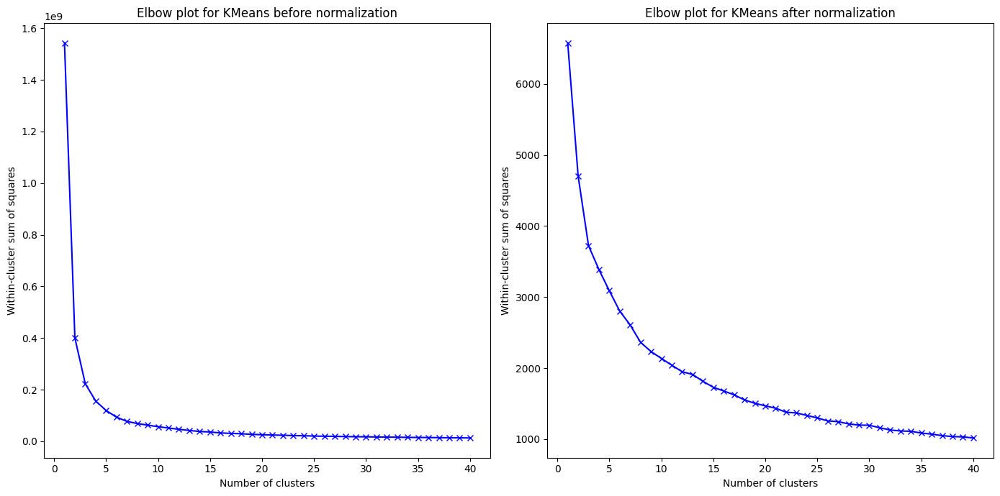

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Function to calculate WCSS (within-cluster sum of squares)
def count_wcss_scores(X, k_max):
    scores = []
    for k in range(1, k_max+1):
        kmeans = KMeans(n_clusters=k, n_init=10, random_state=0)
        kmeans.fit(X)
        wcss = kmeans.inertia_  # inertia_ returns WCSS
        scores.append(wcss)
    return scores

# Assuming 'final_df' is your DataFrame with your data
# Exclude the columns 'label', 'cluster', 'time' and 'seconds_elapsed'
columns_to_exclude = ['label', 'cluster', 'time', 'seconds_elapsed']

data_for_clustering = merged_df_copy.drop(columns=columns_to_exclude, errors='ignore')
data_for_clustering_2 = final_df.drop(columns=columns_to_exclude, errors='ignore')

# Calculate WCSS for different values of k
wcss_vec_1 = count_wcss_scores(data_for_clustering, 40)
wcss_vec_2 = count_wcss_scores(data_for_clustering_2, 40)

x_ticks = list(range(1, len(wcss_vec_1) + 1))

# Plotting the Elbow plots side by side
fig, axes = plt.subplots(1, 2, figsize=(14, 7))

# First plot
axes[0].plot(x_ticks, wcss_vec_1, 'bx-')
axes[0].set_xlabel('Number of clusters')
axes[0].set_ylabel('Within-cluster sum of squares')
axes[0].set_title('Elbow plot for KMeans before normalization')

# Second plot
axes[1].plot(x_ticks, wcss_vec_2, 'bx-')
axes[1].set_xlabel('Number of clusters')
axes[1].set_ylabel('Within-cluster sum of squares')
axes[1].set_title('Elbow plot for KMeans after normalization')

plt.tight_layout()
plt.show()

### Reasing why we will work with 3 clusters

Because before normalization it is seen clearly that it is rational to take 3 clusters, after linear changes it is not seen in easy way, but before and after normalization plots will look similar

### validation whether everything works(beacuse we have labels we can approach supervised learning)

- here we are testing for only Standarization

In [21]:
import warnings
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from scipy.stats import mode

# Ignorowanie ostrzeżeń
warnings.filterwarnings('ignore')

# Usunięcie kolumn 'seconds_elapsed' oraz 'time'
columns_to_drop = [col for col in final_df.columns if 'seconds_elapsed' in col or col == 'time']
data_for_clustering = final_df.drop(columns=columns_to_drop)

# Wyodrębnienie prawdziwych etykiet
data_for_clustering = data_for_clustering.drop(columns=['label'])

# Normalizacja danych
scaler = StandardScaler()
normalized_data = scaler.fit_transform(data_for_clustering)

# Wykonanie klasteryzacji K-means
#TO EXPLAIN LETTER, LOKIEC TAK WYSZEDL
num_clusters = 3 # Ustaw liczbę klastrów na liczbę unikalnych etykiet
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
clusters = kmeans.fit_predict(normalized_data)

# Wykonanie klasteryzacji K-medoids
kmedoids = KMedoids(n_clusters=num_clusters, random_state=42)
clusters_metodois = kmedoids.fit_predict(normalized_data)

# Dodanie informacji o klastrze do oryginalnego DataFrame
final_df['cluster'] = clusters
final_df['cluster_metodois'] = clusters_metodois

### Algomerative clustering section

In [22]:
# Funkcja do wykonania klasteryzacji aglomeracyjnej i dodania kolumny z wynikami
def add_agglomerative_clusters(df, X, linkage, cluster_col_name):
    model = AgglomerativeClustering(n_clusters=num_clusters, linkage=linkage)
    clusters = model.fit_predict(X)
    df[cluster_col_name] = clusters
    return df

# Dodanie kolumn z wynikami dla różnych metod aglomeracyjnych
for linkage in ['ward', 'complete', 'average', 'single']:
    cluster_col_name = f'cluster_{linkage}_linkage'
    final_df = add_agglomerative_clusters(final_df, normalized_data, linkage, cluster_col_name)

## since now we do not use label


In [23]:
modified_features= final_df.drop(columns=['label'])

In [24]:
modified_features

,time,seconds_elapsed,location_bearingAccuracy,location_speedAccuracy,location_verticalAccuracy,location_horizontalAccuracy,location_speed,location_bearing,location_altitude,location_longitude,...,Pedometer_steps,TotalAcceleration_z,TotalAcceleration_y,TotalAcceleration_x,cluster,cluster_metodois,cluster_ward_linkage,cluster_complete_linkage,cluster_average_linkage,cluster_single_linkage
1309,2023-09-16 07:46:08.347979800,0.138156,0.000000,0.000000,0.935374,0.062383,5.986805e-01,0.962014,0.605889,0.501374,...,0.754156,0.492123,0.635572,0.399213,2,1,0,0,0,0
1973,2023-09-16 07:54:30.318000000,0.521125,0.488963,0.424428,0.461583,0.037032,8.097366e-01,0.954942,0.455266,0.195976,...,0.918747,0.421533,0.591776,0.480869,2,2,0,0,0,0
636,2023-09-14 06:39:57.308000000,0.282076,0.420561,0.388874,0.363622,0.061528,8.274612e-01,0.975907,0.605889,0.393390,...,0.787068,0.494047,0.738471,0.586876,2,2,0,0,0,0
4554,2023-10-18 06:43:31.028680200,0.330629,0.000000,0.000000,0.279415,0.177618,6.296691e-01,0.973723,0.595697,0.419640,...,0.838949,0.397906,0.671419,0.486278,2,1,0,0,0,0
4036,2023-09-16 09:46:18.578459400,0.968314,0.000000,0.000000,0.484430,0.181066,5.710432e-01,0.841215,0.810872,0.745270,...,0.996391,0.515977,0.774270,0.620474,2,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5901,2023-09-14 09:18:06.314000000,0.313056,0.000000,0.556464,0.006324,0.037032,5.610405e-07,0.000000,0.599094,0.018062,...,0.000000,0.391196,0.844282,0.576657,0,0,1,0,0,0
6016,2023-09-14 09:19:51.313000000,0.393163,0.000000,0.543588,0.005527,0.037032,8.634813e-16,0.000000,0.599094,0.016402,...,0.000000,0.425439,0.844230,0.610621,0,0,1,0,0,0
7997,2023-09-16 18:23:16.177952300,0.393664,0.000000,0.000000,0.071641,0.217738,2.982306e-01,0.804412,0.828992,0.938821,...,0.889174,0.445239,0.728934,0.444766,1,0,2,0,0,0
2645,2023-09-16 09:28:18.314000000,0.144146,0.000000,0.208771,0.624091,0.037032,9.693909e-18,0.000000,0.575311,0.054245,...,0.758466,0.510393,0.658020,0.583583,2,0,2,0,0,0


## 3D plots

#### Below we are plotting some 3D plots dependencies using clusters made by KMeans, KMetodois, Single Linkage, Average Linkage, Complete Linkage, Ward Linkage

In [25]:
# Assuming modified_features DataFrame and merged_df are already created as per previous instructions

# Drop 'time' column from modified_features
#modified_features = modified_features.drop(columns=['time'])

# Define the desired order for the cluster categories
cluster_order = CategoricalDtype(categories=[0, 1, 2], ordered=True)

# Add the cluster column back to the features with the desired order
modified_features['cluster'] = modified_features['cluster'].astype(cluster_order)

# Define colors for clusters
cluster_colors = sns.color_palette('colorblind', n_colors=3).as_hex()  # A qualitative color scale with distinct colors

# Columns for (x, y, z) pairs
columns_xyz = [
    ('Gyroscope_x', 'Gyroscope_y', 'Gyroscope_z'),
    ('Magnetometer_x', 'Magnetometer_y', 'Magnetometer_z'),
    ('Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z'),
    ('Gravity_x', 'Gravity_y', 'Gravity_z'),
    ('TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z'),
    ('Orientation_qx', 'Orientation_qy', 'Orientation_qz')
]

# Create scatter plots for each (x, y, z) pair
for x, y, z in columns_xyz:
    fig = px.scatter_3d(
        modified_features,
        x=x,
        y=y,
        z=z,
        color='cluster',
        title=f'3D Scatter Plot for {x}, {y}, {z} KMeans',
        labels={'color': 'Cluster'},
        category_orders={'cluster': [0, 1, 2]},
        color_discrete_sequence=cluster_colors
    )
    fig.update_traces(marker=dict(size=3))
    fig.update_layout(legend=dict(itemsizing='constant'))
    fig.show()

In [26]:

# Assuming modified_features DataFrame and merged_df are already created as per previous instructions

# Drop 'time' column from modified_features
#modified_features = modified_features.drop(columns=['time'])

# Define the desired order for the cluster categories
cluster_order = CategoricalDtype(categories=[0, 1, 2], ordered=True)

# Add the cluster column back to the features with the desired order
modified_features['cluster_metodois'] = modified_features['cluster_metodois'].astype(cluster_order)

# Define colors for clusters
cluster_colors = sns.color_palette('colorblind', n_colors=3).as_hex()  # A qualitative color scale with distinct colors

# Columns for (x, y, z) pairs
columns_xyz = [
    ('Gyroscope_x', 'Gyroscope_y', 'Gyroscope_z'),
    ('Magnetometer_x', 'Magnetometer_y', 'Magnetometer_z'),
    ('Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z'),
    ('Gravity_x', 'Gravity_y', 'Gravity_z'),
    ('TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z'),
    ('Orientation_qx', 'Orientation_qy', 'Orientation_qz')
]

# Create scatter plots for each (x, y, z) pair
for x, y, z in columns_xyz:
    fig = px.scatter_3d(
        modified_features,
        x=x,
        y=y,
        z=z,
        color='cluster',
        title=f'3D Scatter Plot for {x}, {y}, {z} KMetodois',
        labels={'color': 'Cluster'},
        category_orders={'cluster': [0, 1, 2]},
        color_discrete_sequence=cluster_colors
    )
    fig.update_traces(marker=dict(size=3))
    fig.update_layout(legend=dict(itemsizing='constant'))
    fig.show()

In [27]:
cluster_order = CategoricalDtype(categories=[0, 1, 2], ordered=True)
final_df['cluster_single_linkage'] = final_df['cluster_single_linkage'].astype(cluster_order)

# Definiowanie kolorów dla klastrów
cluster_colors = sns.color_palette('colorblind', n_colors=3).as_hex()  # Skala kolorów

# Kolumny dla (x, y, z) par
columns_xyz = [
    ('Gyroscope_x', 'Gyroscope_y', 'Gyroscope_z'),
    ('Magnetometer_x', 'Magnetometer_y', 'Magnetometer_z'),
    ('Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z'),
    ('Gravity_x', 'Gravity_y', 'Gravity_z'),
    ('TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z'),
    ('Orientation_qx', 'Orientation_qy', 'Orientation_qz')
]

# Tworzenie scatter plotów dla każdej (x, y, z) pary
for x, y, z in columns_xyz:
    fig = px.scatter_3d(
        final_df,
        x=x,
        y=y,
        z=z,
        color='cluster_single_linkage',
        title=f'3D Scatter Plot for {x}, {y}, {z} - Single Linkage',
        labels={'color': 'Cluster'},
        category_orders={'cluster_single_linkage': [0, 1, 2]},
        color_discrete_sequence=cluster_colors
    )
    fig.update_traces(marker=dict(size=3))
    fig.update_layout(legend=dict(itemsizing='constant'))
    fig.show()

In [28]:
cluster_order = CategoricalDtype(categories=[0, 1, 2], ordered=True)
final_df['cluster_average_linkage'] = final_df['cluster_average_linkage'].astype(cluster_order)

# Definiowanie kolorów dla klastrów
cluster_colors = sns.color_palette('colorblind', n_colors=3).as_hex()  # Skala kolorów

# Kolumny dla (x, y, z) par
columns_xyz = [
    ('Gyroscope_x', 'Gyroscope_y', 'Gyroscope_z'),
    ('Magnetometer_x', 'Magnetometer_y', 'Magnetometer_z'),
    ('Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z'),
    ('Gravity_x', 'Gravity_y', 'Gravity_z'),
    ('TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z'),
    ('Orientation_qx', 'Orientation_qy', 'Orientation_qz')
]

# Tworzenie scatter plotów dla każdej (x, y, z) pary
for x, y, z in columns_xyz:
    fig = px.scatter_3d(
        final_df,
        x=x,
        y=y,
        z=z,
        color='cluster_average_linkage',
        title=f'3D Scatter Plot for {x}, {y}, {z} - Average Linkage',
        labels={'color': 'Cluster'},
        category_orders={'cluster_average_linkage': [0, 1, 2]},
        color_discrete_sequence=cluster_colors
    )
    fig.update_traces(marker=dict(size=3))
    fig.update_layout(legend=dict(itemsizing='constant'))
    fig.show()

In [29]:
cluster_order = CategoricalDtype(categories=[0, 1, 2], ordered=True)
final_df['cluster_complete_linkage'] = final_df['cluster_complete_linkage'].astype(cluster_order)

# Definiowanie kolorów dla klastrów
cluster_colors = sns.color_palette('colorblind', n_colors=3).as_hex()  # Skala kolorów

# Kolumny dla (x, y, z) par
columns_xyz = [
    ('Gyroscope_x', 'Gyroscope_y', 'Gyroscope_z'),
    ('Magnetometer_x', 'Magnetometer_y', 'Magnetometer_z'),
    ('Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z'),
    ('Gravity_x', 'Gravity_y', 'Gravity_z'),
    ('TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z'),
    ('Orientation_qx', 'Orientation_qy', 'Orientation_qz')
]

# Tworzenie scatter plotów dla każdej (x, y, z) pary
for x, y, z in columns_xyz:
    fig = px.scatter_3d(
        final_df,
        x=x,
        y=y,
        z=z,
        color='cluster_complete_linkage',
        title=f'3D Scatter Plot for {x}, {y}, {z} - Average Linkage',
        labels={'color': 'Cluster'},
        category_orders={'cluster_complete_linkage': [0, 1, 2]},
        color_discrete_sequence=cluster_colors
    )
    fig.update_traces(marker=dict(size=3))
    fig.update_layout(legend=dict(itemsizing='constant'))
    fig.show()

In [30]:
cluster_order = CategoricalDtype(categories=[0, 1, 2], ordered=True)
final_df['cluster_ward_linkage'] = final_df['cluster_ward_linkage'].astype(cluster_order)

# Definiowanie kolorów dla klastrów
cluster_colors = sns.color_palette('colorblind', n_colors=3).as_hex()  # Skala kolorów

# Kolumny dla (x, y, z) par
columns_xyz = [
    ('Gyroscope_x', 'Gyroscope_y', 'Gyroscope_z'),
    ('Magnetometer_x', 'Magnetometer_y', 'Magnetometer_z'),
    ('Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z'),
    ('Gravity_x', 'Gravity_y', 'Gravity_z'),
    ('TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z'),
    ('Orientation_qx', 'Orientation_qy', 'Orientation_qz')
]

# Tworzenie scatter plotów dla każdej (x, y, z) pary
for x, y, z in columns_xyz:
    fig = px.scatter_3d(
        final_df,
        x=x,
        y=y,
        z=z,
        color='cluster_ward_linkage',
        title=f'3D Scatter Plot for {x}, {y}, {z} - Ward Linkage',
        labels={'color': 'Cluster'},
        category_orders={'cluster_ward_linkage': [0, 1, 2]},
        color_discrete_sequence=cluster_colors
    )
    fig.update_traces(marker=dict(size=3))
    fig.update_layout(legend=dict(itemsizing='constant'))
    fig.show()

## 2D plots for Location features

In [31]:
modified_features.columns

Index(['time', 'seconds_elapsed', 'location_bearingAccuracy',
       'location_speedAccuracy', 'location_verticalAccuracy',
       'location_horizontalAccuracy', 'location_speed', 'location_bearing',
       'location_altitude', 'location_longitude', 'location_latitude',
       'Gyroscope_z', 'Gyroscope_y', 'Gyroscope_x', 'Magnetometer_z',
       'Magnetometer_y', 'Magnetometer_x', 'Orientation_qz', 'Orientation_qy',
       'Orientation_qx', 'Orientation_qw', 'Orientation_roll',
       'Orientation_pitch', 'Orientation_yaw', 'Accelerometer_z',
       'Accelerometer_y', 'Accelerometer_x', 'Gravity_z', 'Gravity_y',
       'Gravity_x', 'Pedometer_steps', 'TotalAcceleration_z',
       'TotalAcceleration_y', 'TotalAcceleration_x', 'cluster',
       'cluster_metodois', 'cluster_ward_linkage', 'cluster_complete_linkage',
       'cluster_average_linkage', 'cluster_single_linkage'],
      dtype='object')

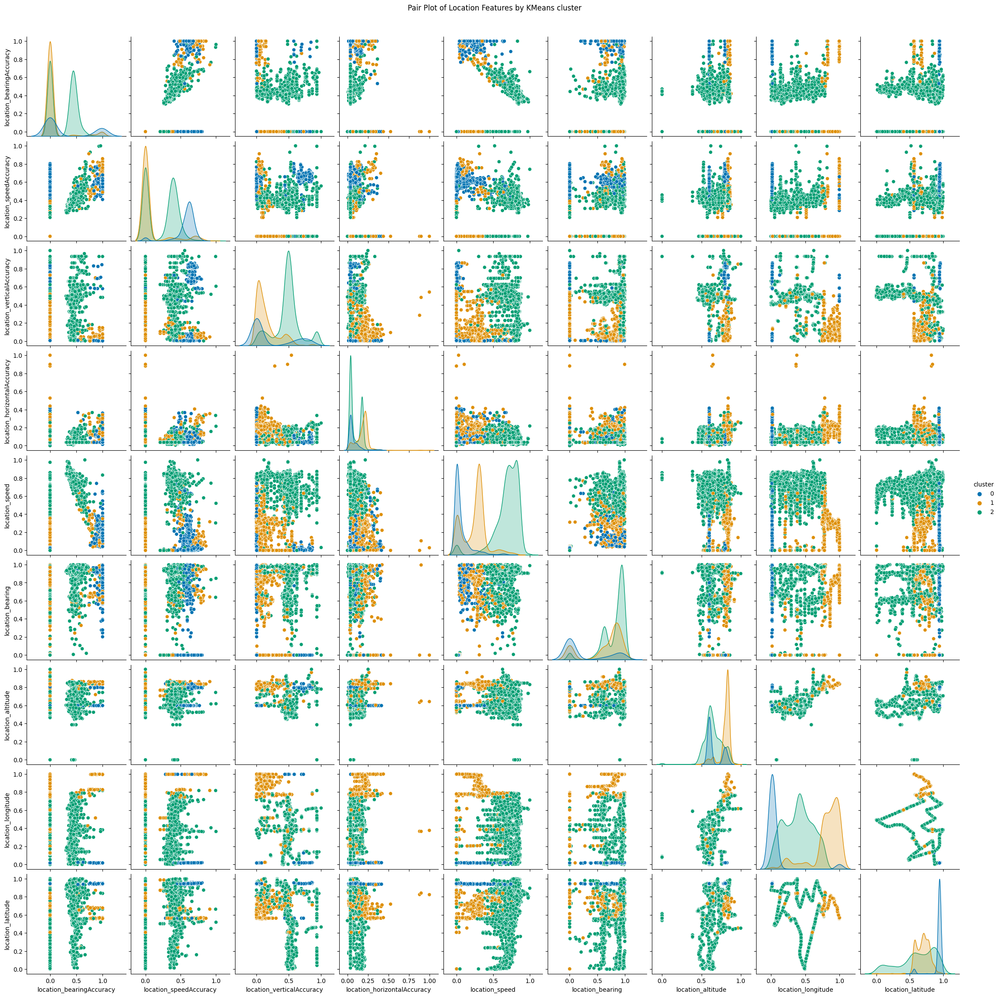

In [ ]:
# List of location columns
location_columns = [
    'location_bearingAccuracy',
    'location_speedAccuracy', 
    'location_verticalAccuracy',
    'location_horizontalAccuracy', 
    'location_speed', 
    'location_bearing',
    'location_altitude', 
    'location_longitude', 
    'location_latitude'
]

# Create pair plot
pairplot = sns.pairplot(modified_features[location_columns + ['cluster']], hue='cluster', palette='colorblind')

pairplot.fig.suptitle('Pair Plot of Location Features by KMeans cluster', y=1.02)

# Show plot
plt.show()

In [ ]:
# List of location columns
location_columns = [
    'location_bearingAccuracy',
    'location_speedAccuracy', 
    'location_verticalAccuracy',
    'location_horizontalAccuracy', 
    'location_speed', 
    'location_bearing',
    'location_altitude', 
    'location_longitude', 
    'location_latitude'
]

# Create pair plot
pairplot = sns.pairplot(modified_features[location_columns + ['cluster_metodois']], hue='cluster_metodois', palette='colorblind')

pairplot.fig.suptitle('Pair Plot of Location Features by KMetodois cluster', y=1.02)

# Show plot
plt.show()

In [ ]:
# List of location columns
location_columns = [
    'location_bearingAccuracy',
    'location_speedAccuracy', 
    'location_verticalAccuracy',
    'location_horizontalAccuracy', 
    'location_speed', 
    'location_bearing',
    'location_altitude', 
    'location_longitude', 
    'location_latitude'
]

# Create pair plot
pairplot = sns.pairplot(modified_features[location_columns + ['cluster_ward_linkage']], hue='cluster_ward_linkage', palette='colorblind')

pairplot.fig.suptitle('Pair Plot of Location Features by Cluster ward linkage', y=1.02)

# Show plot
plt.show()

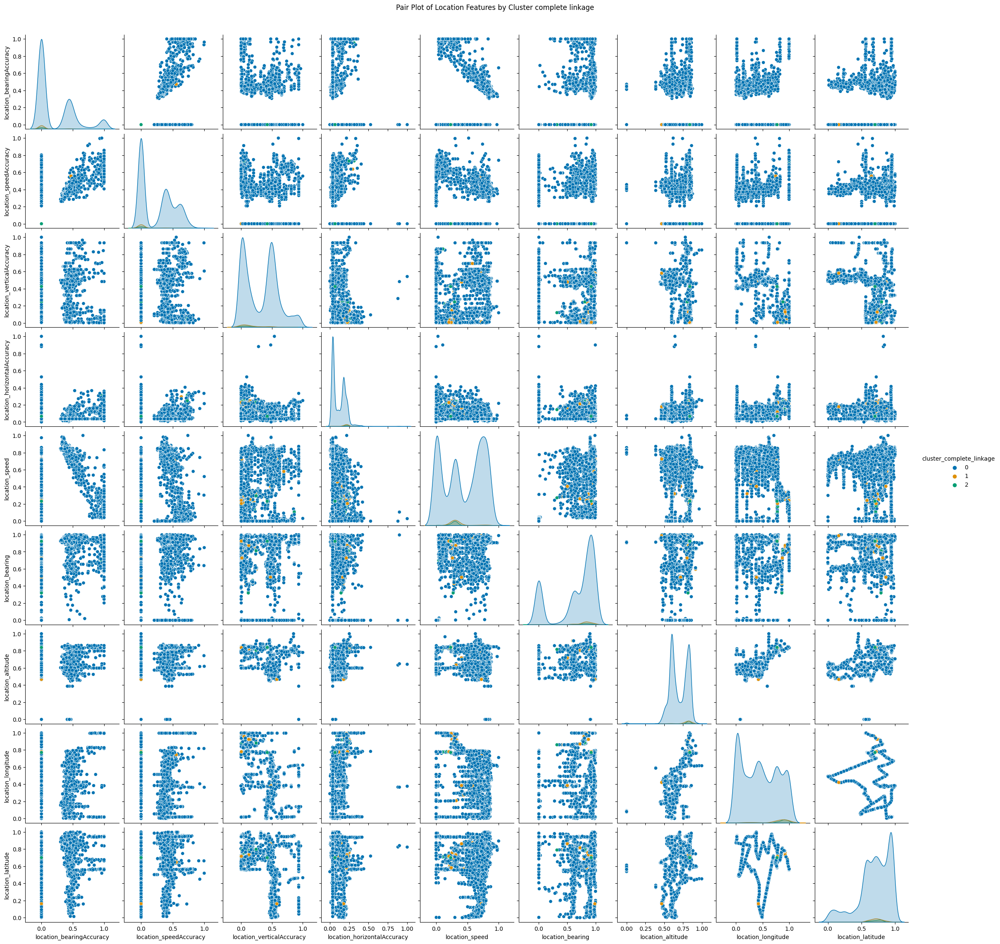

In [35]:
# List of location columns
location_columns = [
    'location_bearingAccuracy',
    'location_speedAccuracy', 
    'location_verticalAccuracy',
    'location_horizontalAccuracy', 
    'location_speed', 
    'location_bearing',
    'location_altitude', 
    'location_longitude', 
    'location_latitude'
]

# Create pair plot
pairplot = sns.pairplot(modified_features[location_columns + ['cluster_complete_linkage']], hue='cluster_complete_linkage', palette='colorblind')

pairplot.fig.suptitle('Pair Plot of Location Features by Cluster complete linkage', y=1.02)

# Show plot
plt.show()

In [ ]:
# List of location columns
location_columns = [
    'location_bearingAccuracy',
    'location_speedAccuracy', 
    'location_verticalAccuracy',
    'location_horizontalAccuracy', 
    'location_speed', 
    'location_bearing',
    'location_altitude', 
    'location_longitude', 
    'location_latitude'
]

# Create pair plot
pairplot = sns.pairplot(modified_features[location_columns + ['cluster_single_linkage']], hue='cluster_single_linkage', palette='colorblind')

pairplot.fig.suptitle('Pair Plot of Location Features by Cluster single linkage', y=1.02)

# Show plot
plt.show()

In [ ]:
# List of location columns
location_columns = [
    'location_bearingAccuracy',
    'location_speedAccuracy', 
    'location_verticalAccuracy',
    'location_horizontalAccuracy', 
    'location_speed', 
    'location_bearing',
    'location_altitude', 
    'location_longitude', 
    'location_latitude'
]

# Create pair plot
pairplot = sns.pairplot(modified_features[location_columns + ['cluster_average_linkage']], hue='cluster_average_linkage', palette='colorblind')

pairplot.fig.suptitle('Pair Plot of Location Features by Cluster average linkage', y=1.02)

# Show plot
plt.show()

# Plots 2D for rest of the features

In [38]:
modified_features.columns

Index(['time', 'seconds_elapsed', 'location_bearingAccuracy',
       'location_speedAccuracy', 'location_verticalAccuracy',
       'location_horizontalAccuracy', 'location_speed', 'location_bearing',
       'location_altitude', 'location_longitude', 'location_latitude',
       'Gyroscope_z', 'Gyroscope_y', 'Gyroscope_x', 'Magnetometer_z',
       'Magnetometer_y', 'Magnetometer_x', 'Orientation_qz', 'Orientation_qy',
       'Orientation_qx', 'Orientation_qw', 'Orientation_roll',
       'Orientation_pitch', 'Orientation_yaw', 'Accelerometer_z',
       'Accelerometer_y', 'Accelerometer_x', 'Gravity_z', 'Gravity_y',
       'Gravity_x', 'Pedometer_steps', 'TotalAcceleration_z',
       'TotalAcceleration_y', 'TotalAcceleration_x', 'cluster',
       'cluster_metodois', 'cluster_ward_linkage', 'cluster_complete_linkage',
       'cluster_average_linkage', 'cluster_single_linkage'],
      dtype='object')

- we will start from KMeans

In [39]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of columns to exclude
exclude_columns = location_columns + ['seconds_elapsed'] + ['cluster_single_linkage', 'cluster_average_linkage', 'cluster_complete_linkage', 'cluster_ward_linkage']

# List of columns to include in the pair plot
include_columns = [col for col in modified_features.columns if col not in exclude_columns + ['cluster']]

# Create pair plot
pairplot = sns.pairplot(modified_features[include_columns + ['cluster']], hue='cluster', palette='colorblind')

# Add title
pairplot.fig.suptitle('Pair Plot of Features by KMeans cluster (excluding location and seconds_elapsed)', y=1.02)

pairplot.fig.savefig('pairplot_high_resolution_kmeans.png', dpi=300, bbox_inches='tight')

# Show plot
plt.show()

KeyboardInterrupt: 

- KMetodois section

- single linkage

In [ ]:
modified_features.columns

Index(['time', 'seconds_elapsed', 'location_bearingAccuracy',
       'location_speedAccuracy', 'location_verticalAccuracy',
       'location_horizontalAccuracy', 'location_speed', 'location_bearing',
       'location_altitude', 'location_longitude', 'location_latitude',
       'Gyroscope_z', 'Gyroscope_y', 'Gyroscope_x', 'Magnetometer_z',
       'Magnetometer_y', 'Magnetometer_x', 'Orientation_qz', 'Orientation_qy',
       'Orientation_qx', 'Orientation_qw', 'Orientation_roll',
       'Orientation_pitch', 'Orientation_yaw', 'Accelerometer_z',
       'Accelerometer_y', 'Accelerometer_x', 'Gravity_z', 'Gravity_y',
       'Gravity_x', 'Pedometer_steps', 'TotalAcceleration_z',
       'TotalAcceleration_y', 'TotalAcceleration_x', 'cluster',
       'cluster_metodois', 'cluster_ward_linkage', 'cluster_complete_linkage',
       'cluster_average_linkage', 'cluster_single_linkage'],
      dtype='object')

### Considering the influence of the time-elapsed

- now the section for time dependencies

In [ ]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Lista kolumn do porównania z 'seconds_elapsed'
columns_to_plot = ['TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z', 
                   'Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z']

# Tworzenie subplots
fig = make_subplots(rows=len(columns_to_plot), cols=1, shared_xaxes=True, 
                    vertical_spacing=0.03, subplot_titles=[f'seconds_elapsed vs {col}' for col in columns_to_plot])

# Dodawanie wykresów do subplots
for i, col in enumerate(columns_to_plot):
    scatter = px.scatter(final_df, x='seconds_elapsed', y=col, color='cluster', 
                         labels={'seconds_elapsed': 'Czas (znormalizowany)', col: f'{col} (znormalizowane)', 'cluster': 'Cluster'},
                         category_orders={'cluster': [0, 1, 2]})
    
    for trace in scatter.data:
        fig.add_trace(trace, row=i+1, col=1)

# Ustawienia układu
fig.update_layout(height=300*len(columns_to_plot), title_text="Zależność różnych zmiennych od seconds_elapsed KMeans")

# Wyświetlenie wykresu
fig.show()

In [ ]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Lista kolumn do porównania z 'seconds_elapsed'
columns_to_plot = ['location_bearingAccuracy', 'Gyroscope_z', 'Gyroscope_y', 'Gyroscope_x',
                   'Magnetometer_z', 'Magnetometer_y', 'Magnetometer_x','Gravity_z', 'Gravity_y', 'Gravity_x']

# Tworzenie subplots
fig = make_subplots(rows=len(columns_to_plot), cols=1, shared_xaxes=True, 
                    vertical_spacing=0.03, subplot_titles=[f'seconds_elapsed vs {col}' for col in columns_to_plot])

# Dodawanie wykresów do subplots
for i, col in enumerate(columns_to_plot):
    scatter = px.scatter(final_df, x='seconds_elapsed', y=col, color='cluster', 
                         labels={'seconds_elapsed': 'Czas (znormalizowany)', col: f'{col} (znormalizowane)', 'cluster': 'Cluster'},
                         category_orders={'cluster': [0, 1, 2]})
    
    for trace in scatter.data:
        fig.add_trace(trace, row=i+1, col=1)

# Ustawienia układu
fig.update_layout(height=300*len(columns_to_plot), title_text="Zależność różnych zmiennych od seconds_elapsed KMeans")

# Wyświetlenie wykresu
fig.show()

- Now the same visualization types but for KMetodois

In [ ]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Lista kolumn do porównania z 'seconds_elapsed'
columns_to_plot = ['TotalAcceleration_x', 'TotalAcceleration_y', 'TotalAcceleration_z', 
                   'Accelerometer_x', 'Accelerometer_y', 'Accelerometer_z']

# Tworzenie subplots
fig = make_subplots(rows=len(columns_to_plot), cols=1, shared_xaxes=True, 
                    vertical_spacing=0.03, subplot_titles=[f'seconds_elapsed vs {col}' for col in columns_to_plot])

# Dodawanie wykresów do subplots
for i, col in enumerate(columns_to_plot):
    scatter = px.scatter(final_df, x='seconds_elapsed', y=col, color='cluster_metodois', 
                         labels={'seconds_elapsed': 'Czas (znormalizowany)', col: f'{col} (znormalizowane)', 'cluster_metodois': 'Cluster Metodois'},
                         category_orders={'cluster_metodois': [0, 1, 2]})
    
    for trace in scatter.data:
        fig.add_trace(trace, row=i+1, col=1)

# Ustawienia układu
fig.update_layout(height=300*len(columns_to_plot), title_text="Zależność różnych zmiennych od seconds_elapsed KMetodis")

# Wyświetlenie wykresu
fig.show()

In [ ]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Lista kolumn do porównania z 'seconds_elapsed'
columns_to_plot = ['location_bearingAccuracy', 'Gyroscope_z', 'Gyroscope_y', 'Gyroscope_x',
                   'Magnetometer_z', 'Magnetometer_y', 'Magnetometer_x','Gravity_z', 'Gravity_y', 'Gravity_x']

# Tworzenie subplots
fig = make_subplots(rows=len(columns_to_plot), cols=1, shared_xaxes=True, 
                    vertical_spacing=0.03, subplot_titles=[f'seconds_elapsed vs {col}' for col in columns_to_plot])

# Dodawanie wykresów do subplots
for i, col in enumerate(columns_to_plot):
    scatter = px.scatter(final_df, x='seconds_elapsed', y=col, color='cluster_metodois', 
                         labels={'seconds_elapsed': 'Czas (znormalizowany)', col: f'{col} (znormalizowane)', 'cluster_metodois': 'Cluster Metodois'},
                         category_orders={'cluster_metodois': [0, 1, 2]})
    
    for trace in scatter.data:
        fig.add_trace(trace, row=i+1, col=1)

# Ustawienia układu
fig.update_layout(height=300*len(columns_to_plot), title_text="Zależność różnych zmiennych od seconds_elapsed KMetodis")

# Wyświetlenie wykresu
fig.show()

## Histogram for steps

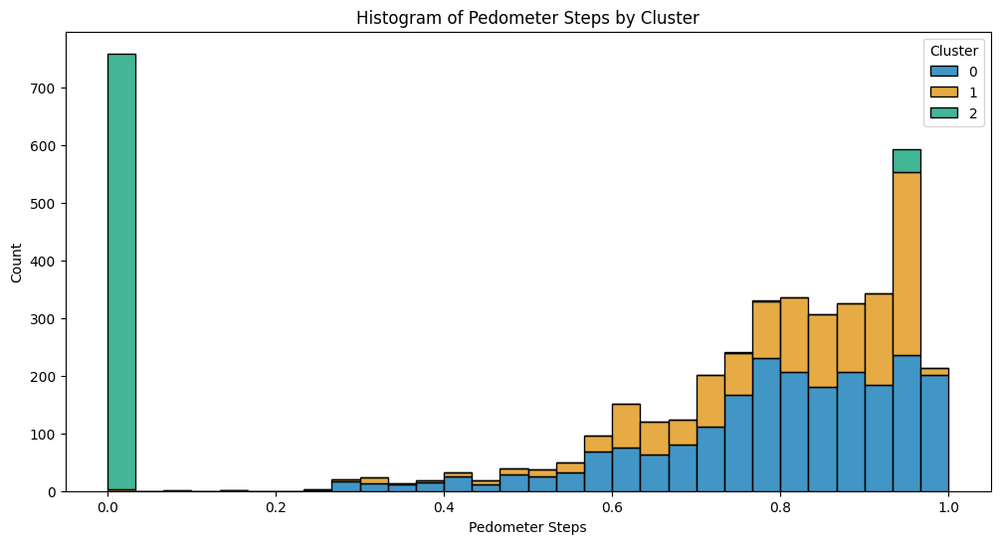

In [ ]:
cluster_colors_seaborn = sns.color_palette('colorblind', n_colors=3).as_hex()
cluster_colors_seaborn[0], cluster_colors_seaborn[2] = cluster_colors_seaborn[2], cluster_colors_seaborn[0]

# Create histograms for Pedometer_steps for each cluster
plt.figure(figsize=(12, 6))
sns.histplot(data=modified_features, x='Pedometer_steps', hue='cluster', multiple='stack', palette=cluster_colors_seaborn, bins=30)
plt.title('Histogram of Pedometer Steps by Cluster')
plt.xlabel('Pedometer Steps')
plt.ylabel('Count')
plt.legend(title='Cluster', labels=[0, 1, 2])
plt.show()